In [1]:
import pandas as pd

In [2]:
df = pd.read_csv("../dataset/undersampling_dataset_50.csv").dropna().reset_index(drop=True)

df

,X_LOC,Y_LOC,DEPT,NPHI,DTC,SP,RHOB,GR,CALI,Lithology_code
0,483529.78125,6590317.5,1856.118000,0.413756,116.761692,118.643547,2.165838,68.089821,12.274452,99000.0
1,444165.68750,6435564.0,2563.007790,0.220407,65.398209,108.007538,2.554887,11.922521,12.570300,70032.0
2,449956.81250,6500258.5,2832.345604,0.028278,50.599144,84.215668,2.576733,80.928802,12.336000,65030.0
3,442440.43750,6759336.5,3661.138001,0.260660,82.386101,58.316132,2.656438,88.519730,8.490198,65000.0
4,515574.43750,6495507.0,1213.974793,0.327166,105.174644,31.042135,2.294112,19.124099,18.285646,70032.0
...,...,...,...,...,...,...,...,...,...,...
155288,483526.62500,6590320.5,2057.974000,0.180640,84.731209,121.727313,2.537026,68.534492,12.195006,70000.0
155289,442443.37500,6759392.0,1298.450001,0.297358,144.449600,57.867142,2.427852,43.589630,17.878799,65030.0
155290,515574.43750,6495507.0,1320.526793,0.313288,84.315750,32.037045,2.262872,19.893385,18.423449,70032.0
155291,520153.18750,6452287.5,2587.601016,0.039551,67.738098,129.296502,2.088810,11.780769,12.209307,88000.0


In [3]:
main_column = ["GR", "NPHI", "RHOB", "DTC"]

In [4]:
main_dataset = df[main_column]

## Check Correlation Heatmap

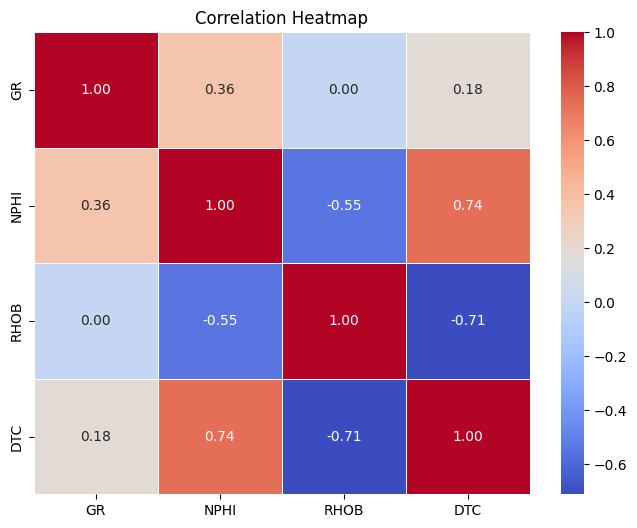

In [6]:
import matplotlib.pyplot as plt
import seaborn as sns


plt.figure(figsize=(8, 6))
sns.heatmap(main_dataset.corr(), annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

## PCA

In [7]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import numpy as np

In [8]:
scaler = StandardScaler()
df_scaled = scaler.fit_transform(main_dataset)

df_scaled

array([[ 0.54226866,  0.49168434, -0.2277245 ,  0.03619239],
       [-1.44088189, -0.82373862,  1.2724029 , -1.56321191],
       [ 0.99558639, -2.13085434,  1.35664061, -2.02403906],
       ...,
       [-1.15944725, -0.19183697,  0.14642652, -0.97413978],
       [-1.44588683, -2.05416003, -0.52473465, -1.49035024],
       [-1.42773378, -1.35807676,  0.96191639, -1.35906196]])

In [9]:
pca = PCA(n_components=4)
data_pca = pca.fit_transform(df_scaled)

In [10]:
var_exp = pca.explained_variance_ratio_
cum_var_exp = np.cumsum(var_exp)

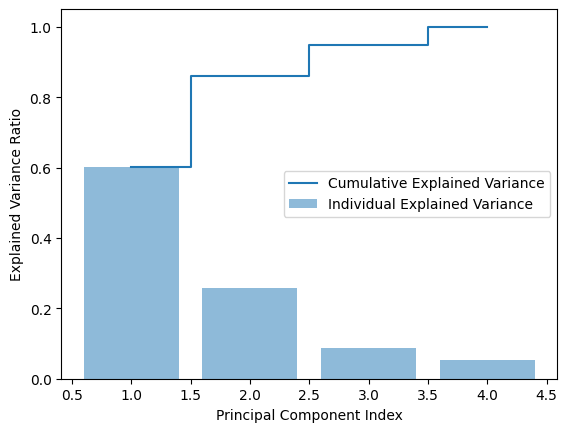

In [11]:
plt.bar(range(1, len(var_exp) + 1), var_exp, alpha=0.5, align='center',
        label='Individual Explained Variance')
plt.step(range(1, len(cum_var_exp) + 1), cum_var_exp, where='mid',
         label='Cumulative Explained Variance')

plt.ylabel('Explained Variance Ratio')
plt.xlabel('Principal Component Index')
plt.legend(loc='best')
plt.show()

## PC = 2

In [12]:
pca = PCA(n_components=2)
df_pca = pd.DataFrame(pca.fit_transform(df_scaled), 
                      columns=['PC1', 'PC2'])

df_pca

,PC1,PC2
0,0.543233,0.464357
1,-2.384748,-0.689433
2,-2.899724,1.377260
3,-1.509447,1.850609
4,-0.654454,-0.922333
...,...,...
155288,-1.696328,0.941382
155289,-0.119588,-0.144554
155290,-1.024472,-0.871925
155291,-2.109418,-1.616564


In [13]:
df_pca['Label'] = df['Lithology_code']

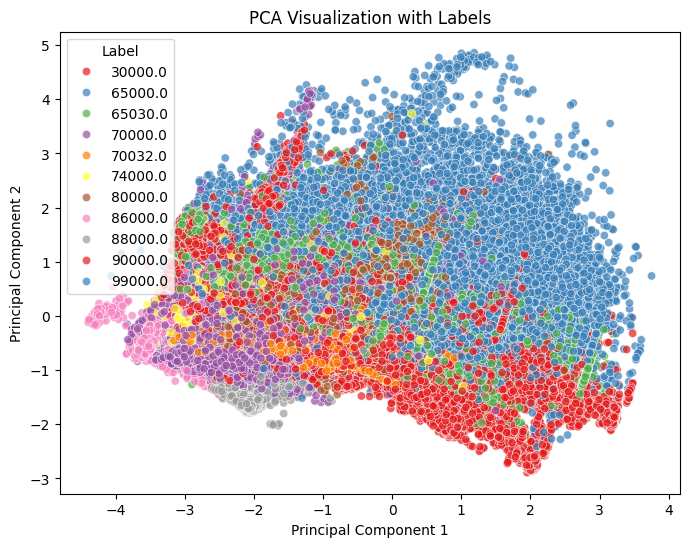

In [14]:
import seaborn as sns

plt.figure(figsize=(8, 6))
sns.scatterplot(x=df_pca['PC1'], y=df_pca['PC2'], hue=df_pca['Label'], palette='Set1', alpha=0.7)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA Visualization with Labels')
plt.legend(title='Label')
plt.show()

## PC = 3

In [15]:
pca = PCA(n_components=3)
df_pca = pd.DataFrame(pca.fit_transform(df_scaled), 
                      columns=['PC1', 'PC2', 'PC3'])

df_pca

,PC1,PC2,PC3
0,0.543233,0.464357,-0.052339
1,-2.384748,-0.689433,0.684311
2,-2.899724,1.377260,-1.078036
3,-1.509447,1.850609,0.139196
4,-0.654454,-0.922333,0.533660
...,...,...,...
155288,-1.696328,0.941382,-0.222552
155289,-0.119588,-0.144554,0.583998
155290,-1.024472,-0.871925,0.295554
155291,-2.109418,-1.616564,-1.267550


In [16]:
df_pca['Label'] = df['Lithology_code'].astype(int).astype(str)

In [17]:
df_pca['Label'].isna().sum()

0

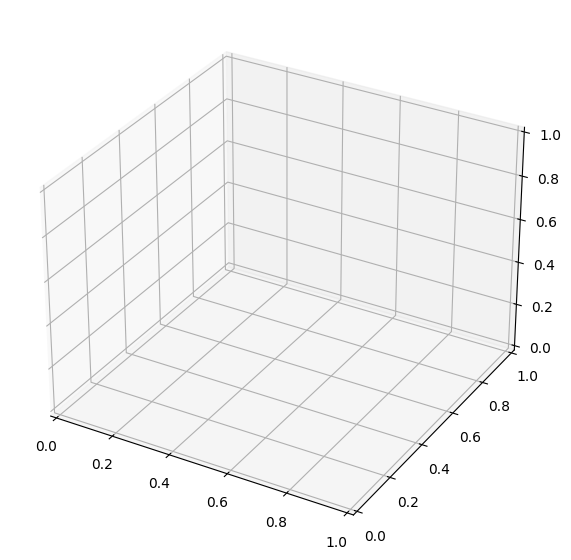

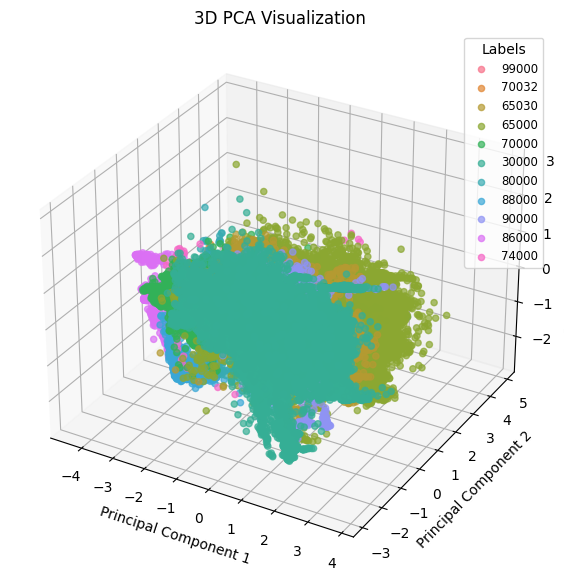

In [18]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Create 3D plot
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

# Define colors for each label
# Generate unique colors using Seaborn palette
unique_labels = df_pca['Label'].unique()
colors = sns.color_palette("husl", len(unique_labels))  # Generate distinct colors
color_map = dict(zip(unique_labels, colors))  # Map labels to colors

# Create 3D figure
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot for each label
for label in unique_labels:
    subset = df_pca[df_pca['Label'] == label]
    ax.scatter(subset['PC1'], subset['PC2'], subset['PC3'], 
               color=[color_map[label]], label=label, alpha=0.7)

# Labels & title
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
ax.set_title('3D PCA Visualization')

# Show legend
ax.legend(loc='best', fontsize='small', title='Labels')

plt.show()



In [19]:
import plotly.express as px
import pandas as pd

# Replace NaN values in labels  # Convert labels to string

# Create interactive 3D scatter plot
fig = px.scatter_3d(
    df_pca, 
    x='PC1', y='PC2', z='PC3', 
    color='Label',  # Color by label
    title='Interactive 3D PCA Visualization',
    opacity=0.8
)

# Show the figure
fig.show()


## Model Machine Learning

In [20]:
df_pca

,PC1,PC2,PC3,Label
0,0.543233,0.464357,-0.052339,99000
1,-2.384748,-0.689433,0.684311,70032
2,-2.899724,1.377260,-1.078036,65030
3,-1.509447,1.850609,0.139196,65000
4,-0.654454,-0.922333,0.533660,70032
...,...,...,...,...
155288,-1.696328,0.941382,-0.222552,70000
155289,-0.119588,-0.144554,0.583998,65030
155290,-1.024472,-0.871925,0.295554,70032
155291,-2.109418,-1.616564,-1.267550,88000


In [21]:
from sklearn.model_selection import train_test_split

In [22]:
df_pca.isna().sum()

PC1      0
PC2      0
PC3      0
Label    0
dtype: int64

In [23]:
X, y = df_pca[["PC1", "PC2", "PC3"]], df_pca["Label"]

In [24]:
y.isna().sum()

0

In [25]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [26]:
y_train.isna().sum()

0

In [27]:
y_test.isna().sum()

0

In [28]:
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report

In [29]:
models = {
    "Logistic Regression": LogisticRegression(),
    "Random Forest": RandomForestClassifier(),
    "KNN": KNeighborsClassifier(),
    "Decision Tree": DecisionTreeClassifier()
}

In [30]:
y_train.isna().sum()

0

In [31]:
# Train and evaluate
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    print(f"Model: {name}")
    
    print(classification_report(y_test, y_pred))

/home/rahmat/.conda/envs/api_rul/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/rahmat/.conda/envs/api_rul/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Model: Logistic Regression


/home/rahmat/.conda/envs/api_rul/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/home/rahmat/.conda/envs/api_rul/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

       30000       0.50      0.71      0.58      8756
       65000       0.58      0.79      0.67      9959
       65030       0.31      0.00      0.01      4071
       70000       0.54      0.65      0.59      3392
       70032       0.00      0.00      0.00      1081
       74000       0.00      0.00      0.00       234
       80000       0.01      0.00      0.00      1665
       86000       0.81      0.61      0.70       165
       88000       0.96      0.98      0.97       757
       90000       0.00      0.00      0.00       211
       99000       0.00      0.00      0.00       768

    accuracy                           0.55     31059
   macro avg       0.34      0.34      0.32     31059
weighted avg       0.46      0.55      0.47     31059

Model: Random Forest
              precision    recall  f1-score   support

       30000       0.81      0.85      0.83      8756
       65000       0.78      0.86      0.82      9959
   